In [1]:
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
from joblib import Parallel, delayed
from pyevtk.hl import pointsToVTK
import smplotlib
from scripts.halo_analysis_scripts import *
from firestudio.studios.gas_studio import GasStudio
from firestudio.studios.star_studio import StarStudio
import utilities.coordinate as utc
import iht
%matplotlib inline
plt.rcParams['figure.dpi'] = 110

In [2]:
from astropy import units as un, constants as cons
plt.rcParams.update({'font.size': 15})
from scipy.stats import binned_statistic

# Load data

In [3]:
keys_to_extract = {
    0:['Coordinates', 'Masses', 'Density', 
    'Temperature', 'InternalEnergy', 'CosmicRayEnergy', 
    'Velocities', 'Metallicity', 'SoundSpeed', 'CoolingRate', 'SmoothingLength', 'MagneticField', 'ParticleIDs'],
    1:['Coordinates', 'Masses', 'Velocities'],
    2:['Coordinates', 'Masses', 'Velocities'],
    4:['Coordinates', 'Masses', 'Velocities', 'ParticleIDs'],
    5:['Coordinates', 'Masses', 'Velocities']
}

In [4]:
def load(s, rot=None):
#     p = load_allparticles('/projects/b1026/snapshots/MassiveFIRE/h206_A1_res33000/', s, [0,1,2,4,5], keys_to_extract=keys_to_extract, loud=0)
    p = load_allparticles('/projects/b1026/isultan/metal_diffusion/cr_heating_fix/m12i_r7100/output', s, [0,1,2,4,5], keys_to_extract=keys_to_extract, loud=0)
#     p[0]['Coordinates0'] = p[0]['Coordinates'].copy()
    
    velC = iht.velocity_COM(p)
    for k in p.keys():
        p[k]['Coordinates'] -= p[k]['posC']
        p[k]['Velocities'] -= velC
    rotnew = iht.rotate_coords(p, p[4]['Rvir'], rot=rot)
    if rot is None:
        return p#, rotnew
    else:
        return p

# res = Parallel(n_jobs=-1, verbose=10)(delayed(load)(s) for s in range(95, 143))
# res = Parallel(n_jobs=-1, verbose=10)(delayed(load)(s) for s in range(95, 143+3))

In [ ]:
p_142, rot_142 = load(142, rot=None)

In [ ]:
res = Parallel(n_jobs=-1, verbose=10)(delayed(load)(s, rot_142) for s in range(95, 143+3))

In [8]:
#z~0 
p_587, rot_587 = load(587, rot=None)

ValueError: too many values to unpack (expected 2)

In [5]:
rot_587 = None
res = Parallel(n_jobs=-1, verbose=10)(delayed(load)(s, rot_587) for s in range(550, 587+4))
# res = Parallel(n_jobs=-1, verbose=10)(delayed(load)(s, rot_587) for s in range(547, 601))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 52 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of  41 | elapsed: 18.9min remaining: 239.9min
[Parallel(n_jobs=-1)]: Done   8 out of  41 | elapsed: 23.0min remaining: 95.0min
[Parallel(n_jobs=-1)]: Done  13 out of  41 | elapsed: 27.7min remaining: 59.7min
[Parallel(n_jobs=-1)]: Done  18 out of  41 | elapsed: 32.3min remaining: 41.3min
[Parallel(n_jobs=-1)]: Done  23 out of  41 | elapsed: 36.6min remaining: 28.6min
[Parallel(n_jobs=-1)]: Done  28 out of  41 | elapsed: 40.9min remaining: 19.0min
[Parallel(n_jobs=-1)]: Done  33 out of  41 | elapsed: 44.9min remaining: 10.9min
[Parallel(n_jobs=-1)]: Done  38 out of  41 | elapsed: 49.1min remaining:  3.9min
[Parallel(n_jobs=-1)]: Done  41 out of  41 | elapsed: 51.6min finished


In [95]:
res2 = Parallel(n_jobs=-1, verbose=10)(delayed(load)(s) for s in list(range(547, 550)) + list(range(587+4, 601)))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 52 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of  13 | elapsed: 10.0min remaining: 54.9min
[Parallel(n_jobs=-1)]: Done   4 out of  13 | elapsed: 11.3min remaining: 25.4min
[Parallel(n_jobs=-1)]: Done   6 out of  13 | elapsed: 12.5min remaining: 14.6min
[Parallel(n_jobs=-1)]: Done   8 out of  13 | elapsed: 13.9min remaining:  8.7min
[Parallel(n_jobs=-1)]: Done  10 out of  13 | elapsed: 15.3min remaining:  4.6min
[Parallel(n_jobs=-1)]: Done  13 out of  13 | elapsed: 17.3min finished


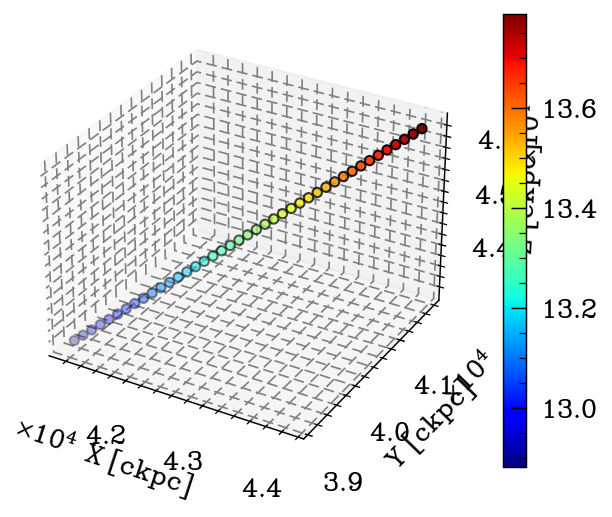

In [55]:
posCall = np.array([p[0]['posC'] for p in res])
fig = plt.figure(dpi=150)
ax = fig.add_subplot(projection='3d')

im = ax.scatter(posCall[:,1], posCall[:,0], posCall[:,2], c=np.array([p[0]['TimeGyr'] for p in res]))

ax.set_xlabel('X [ckpc]')
ax.set_ylabel('Y [ckpc]')
ax.set_zlabel('Z [ckpc]')

plt.colorbar(im)
plt.show()

# Map of halo at $z=2.5$

In [28]:
def plotviz(ax, p, simname, snapnum, cbar=False, ascale=1, boxsize=None, font_color='w', plotType='T', rotate=False, use_metadata=True, Tmin=4.5, Tmax=7, Smin=-3.5, Smax=1, edgeOn=False):
    p0 = p[0]
    datadir='vizdata'
    outdir='vizimages'
    if boxsize is None: boxsize=p0['Rvir']*2.5
    frame_half_thickness=None
    print(boxsize)

    gaspart = {}
    gaspart['Coordinates'] = p0['Coordinates'] / ascale
    gaspart['Masses'] = p0['Masses'] * 1.e10
    gaspart['Metallicity'] = p0['Metallicity']
    gaspart['SmoothingLength'] = p0['SmoothingLength'] / ascale
    gaspart['BoxSize'] = boxsize
    gaspart['Temperature'] = p0['Temperature']
    gaspart['logT'] = np.log10(p0['Temperature'])
    
    if edgeOn: gaspart['Coordinates'] = gaspart['Coordinates'][:, [2, 1, 0]]
    
    gasStudio = GasStudio(
        datadir=datadir, 
        snapnum=snapnum,
        sim_name=simname,
        gas_snapdict = gaspart,
        frame_half_width = boxsize//2,
        scale_bar=True,
        scale_line_length=10,#max(5, 10*round(boxsize/4/10)),#200,
        figure_label=simname,
        figure_label_side='right',
        fontsize=16,
        font_color=font_color,
        use_colorbar=cbar,
        cbar_logspace=False,
        loud=True)
    
    if plotType=='Sigma': #Surface density map 
        gasStudio.set_ImageParams(cbar_label=r'$\log \left[ \Sigma_{\mathrm{gas}}/(\mathrm{M_{\odot}\ pc^{-2}})\right]$')
        gasStudio.render(ax=ax, 
                         weight_name='Masses',
                         min_weight=Smin,
                         max_weight=Smax,
                         weight_adjustment_function= lambda x: np.log10(x/gasStudio.Acell)-6, # Msun/pc^2
                         cmap='magma_r',
                         use_metadata=use_metadata, 
                         load=True)
    elif plotType=='T': #Mass-weighted Temperature map
        if Tmin=='auto':
            idxT = (np.abs(gaspart['Coordinates'][:,0])<(boxsize/2))&(np.abs(gaspart['Coordinates'][:,1])<(boxsize/2))&(np.abs(gaspart['Coordinates'][:,2])<15)
            Tmin, Tmax = np.percentile(gaspart['logT'][idxT], [2,98])
        gasStudio.set_ImageParams(cbar_label=r'$\log (T/\mathrm{K})$')
        gasStudio.render(ax=ax, 
                         weight_name='Masses',
                         quantity_name='logT',
                         min_quantity=Tmin,
                         max_quantity=Tmax,
                         cmap='afmhot_r',
                         use_metadata=use_metadata,
                         loud=True)
    
    print(p0['Rvir'], p0['Redshift'])
    # plt.title(f"z={str(np.around(p0['Redshift'],2)).zfill(2)}, {simname}")

20
setting use_colorbar to user value of: True
setting cbar_logspace to user value of: False
setting cbar_label to default value of: 
setting snapnum to user value of: 142
setting sim_name to user value of: h206_A1_res33000
setting scale_bar to user value of: True
setting scale_line_length to user value of: 10
setting figure_label to user value of: h206_A1_res33000
setting figure_label_side to user value of: right
setting fontsize to user value of: 16
setting font_color to user value of: k
setting camera to user value of: Camera(pos=array([ 0.,  0., 15.]),focus=array([0., 0., 0.]))
setting aspect_ratio to default value of: 1
setting pixels to default value of: 1200
setting noaxis to default value of: True
setting savefig to default value of: None
setting snapdir to default value of: None
setting cbar_label to user value of: $\log \left[ \Sigma_{\mathrm{gas}}/(\mathrm{M_{\odot}\ pc^{-2}})\right]$
projecting 540048 particles
------------------------------------------
--------------------

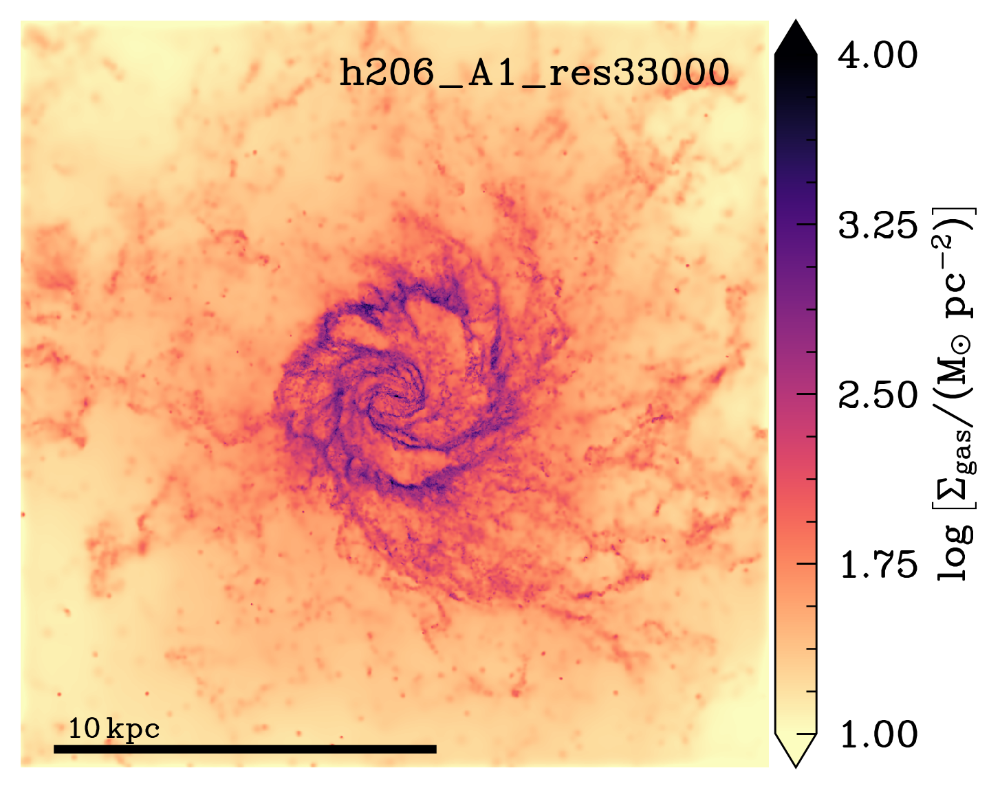

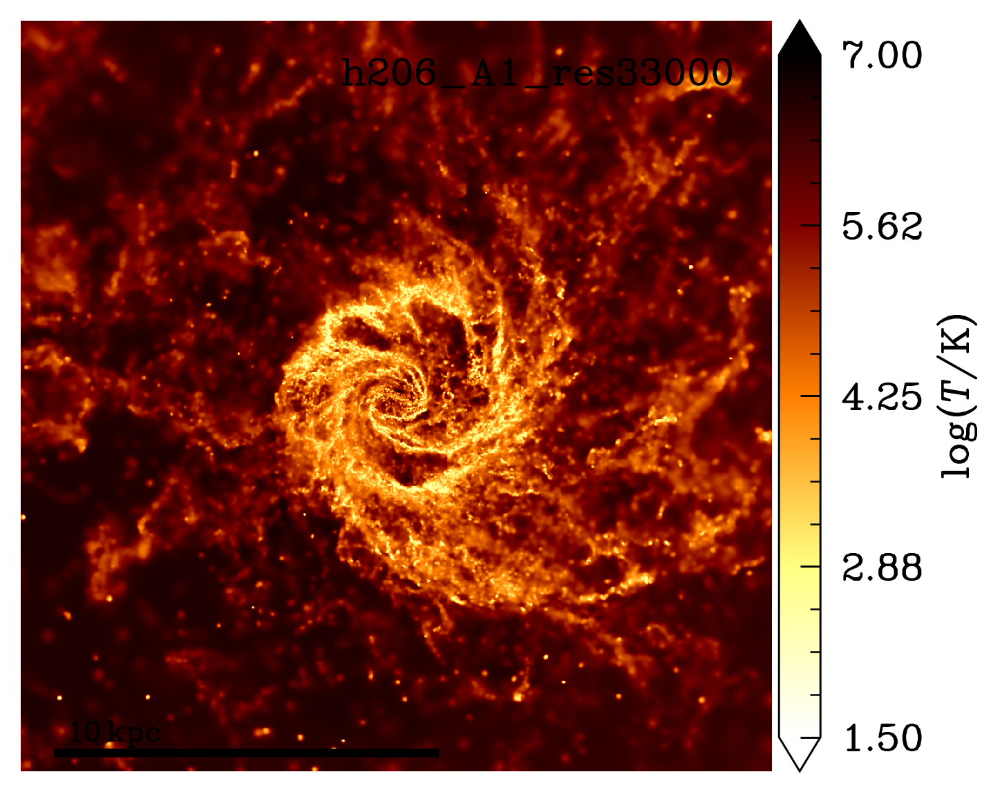

In [29]:
part = res[-1]
simname = 'h206_A1_res33000'
snapnum = 142

for plotType in ['Sigma', 'T']:
    fig, ax = plt.subplots(1, 1, gridspec_kw={'wspace':0, 'hspace':0.0}, figsize=[4.8*1,4.8*1], dpi=300)
    plotviz(ax, part, simname, snapnum, edgeOn=False, boxsize=20,
            cbar=True, plotType=plotType, use_metadata=False, font_color='k',
            Tmin=1.5, Tmax=7, Smin=1, Smax=4)
#             Tmin=4.5, Tmax=7, Smin=-1.75, Smax=2.5)

    #Draw circle of radius Rvir
    circle = plt.Circle((0, 0), part[0]['Rvir'], color='w', fill=False, lw=2, alpha=0.5)
    ax.add_patch(circle)

20
setting use_colorbar to user value of: True
setting cbar_logspace to user value of: False
setting cbar_label to default value of: 
setting snapnum to user value of: 142
setting sim_name to user value of: h206_A1_res33000
setting scale_bar to user value of: True
setting scale_line_length to user value of: 10
setting figure_label to user value of: h206_A1_res33000
setting figure_label_side to user value of: right
setting fontsize to user value of: 16
setting font_color to user value of: k
setting camera to user value of: Camera(pos=array([ 0.,  0., 15.]),focus=array([0., 0., 0.]))
setting aspect_ratio to default value of: 1
setting pixels to default value of: 1200
setting noaxis to default value of: True
setting savefig to default value of: None
setting snapdir to default value of: None
setting cbar_label to user value of: $\log \left[ \Sigma_{\mathrm{gas}}/(\mathrm{M_{\odot}\ pc^{-2}})\right]$
cache npix1200_half_width10.00kpc_zmin0.00kpc_zmax30.00kpc_camera_0.00_0.00_15.00_0.00_0.00

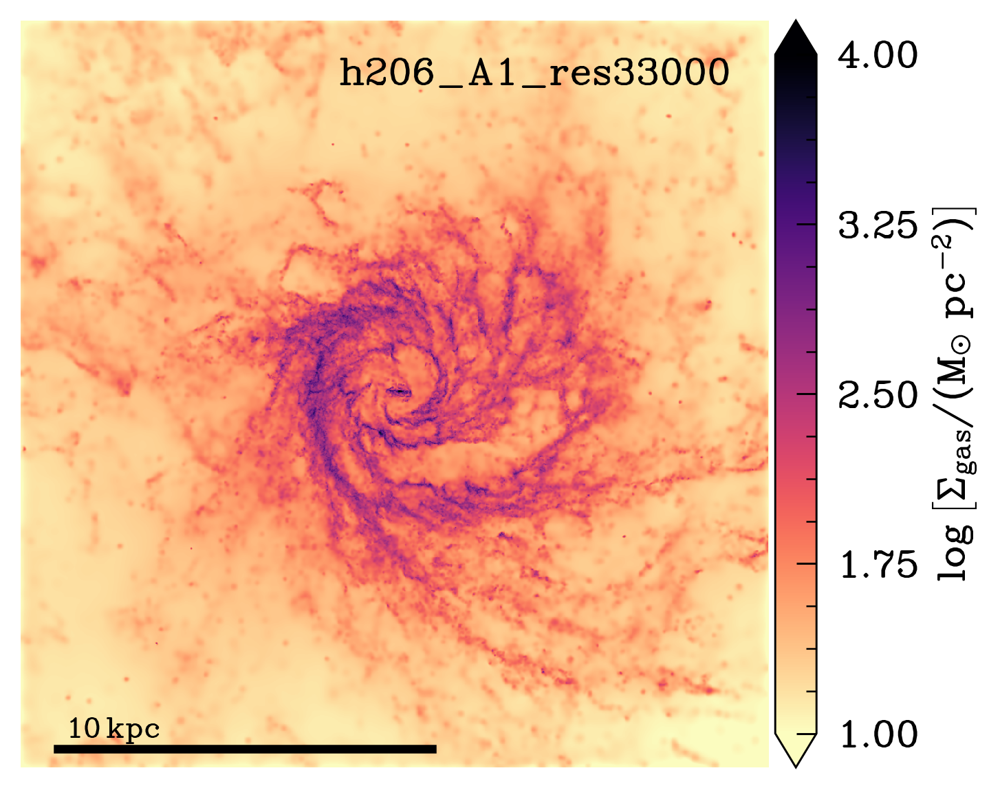

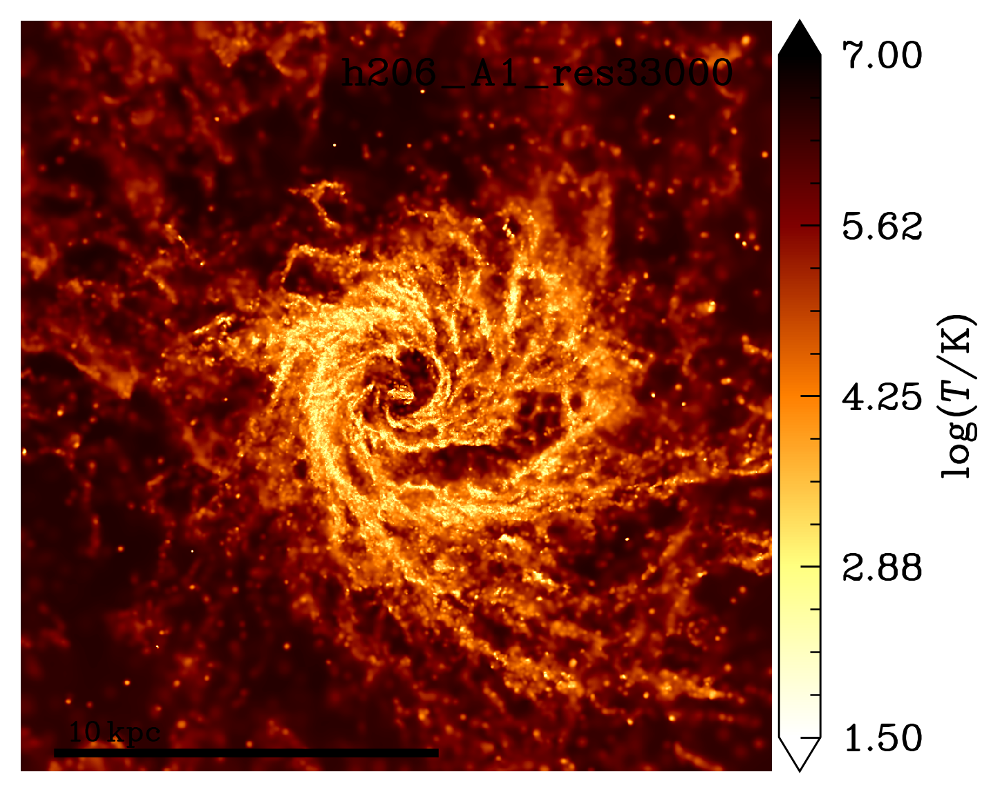

In [61]:
part = res[-1]
simname = 'h206_A1_res33000'
snapnum = 142

for plotType in ['Sigma', 'T']:
    fig, ax = plt.subplots(1, 1, gridspec_kw={'wspace':0, 'hspace':0.0}, figsize=[4.8*1,4.8*1], dpi=300)
    plotviz(ax, part, simname, snapnum, edgeOn=False, boxsize=20,
            cbar=True, plotType=plotType, use_metadata=False, font_color='k',
            Tmin=1.5, Tmax=7, Smin=1, Smax=4)
#             Tmin=4.5, Tmax=7, Smin=-1.75, Smax=2.5)

    #Draw circle of radius Rvir
    circle = plt.Circle((0, 0), part[0]['Rvir'], color='w', fill=False, lw=2, alpha=0.5)
    ax.add_patch(circle)

# Particle tracking

In [16]:
def selectparticles(p_tf, p_ti, aperture=0.1, amountparticles=50):
    mask_tf = p_tf[0]['r_scaled'] < aperture
    mask_ti = p_ti[0]['r_scaled'] > aperture
    
    ParticleIDs, idx_tf, idx_ti = np.intersect1d( p_tf[0]['ParticleIDs'][mask_tf], p_ti[0]['ParticleIDs'][mask_ti], return_indices=True )
    idx_rand = np.random.randint(0, len(ParticleIDs), amountparticles)
    return ParticleIDs[idx_rand], np.flatnonzero(mask_tf)[idx_tf[idx_rand]], np.flatnonzero(mask_ti)[idx_ti[idx_rand]]

In [6]:
un, idxinv, uncnts = np.unique(p_tf[0]['ParticleIDs'], return_inverse=True, return_counts=True)

NameError: name 'p_tf' is not defined

In [20]:
def selectparticles_zach(p_tf, p_ti, aperture=0.05):
    mask_tf = p_tf[0]['r_scaled'] < 0.05
    mask_ti = (1 > p_ti[0]['r_scaled'])&(p_ti[0]['r_scaled'] > 0.1)
    
#     ParticleIDs, idx_tf, idx_ti = np.intersect1d( p_tf[0]['ParticleIDs'][mask_tf], p_ti[0]['ParticleIDs'][mask_ti], return_indices=True )
#     return ParticleIDs, np.flatnonzero(mask_tf)[idx_tf], np.flatnonzero(mask_ti)[idx_ti]

    ParticleIDs, idx_tf, idx_ti = np.intersect1d( p_tf[0]['ParticleIDs'][mask_tf], p_ti[0]['ParticleIDs'][mask_ti], return_indices=True )
    idx_rand = np.flatnonzero( p_tf[0]['Masses'][mask_tf][idx_tf]/p_ti[0]['Masses'][mask_ti][idx_ti] < 2 )
    print(len(idx_tf), len(idx_rand), (len(idx_tf)-len(idx_rand))/len(idx_tf))
    return ParticleIDs[idx_rand], np.flatnonzero(mask_tf)[idx_tf[idx_rand]], np.flatnonzero(mask_ti)[idx_ti[idx_rand]]

In [14]:
for p in tqdm(res):
    p['04'] = {k:np.concatenate([p[i][k] for i in (0,4)]) for k in ('r_scaled', 'Masses', 'ParticleIDs', 'Velocities', 'Coordinates') }

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 41/41 [04:04<00:00,  5.96s/it]


In [13]:
def selectparticles_zach(p_tf, p_ti, aperture=0.05):
    XH = 1 - p_tf[0]['Metallicity'][:,0] - p_tf[0]['Metallicity'][:,1] #hydrogen mass fraction
    nH = ( XH * (p_tf[0]['Density'] * 1e10 * un.Msun/un.kpc**3) / cons.m_p ).to(un.cm**-3).value 
    
    
    mask_tf = (p_tf[0]['r_scaled'] < rgals[-1-3])&(nH > 0.13)
    mask_ti = (1 > p_ti[0]['r_scaled']) & (p_ti[0]['r_scaled'] > 0.1)
    
    # Get the unique ParticleIDs in p_tf with counts
    unique_ids_tf, counts_tf = np.unique(p_tf[0]['ParticleIDs'], return_counts=True)
    
    # Select only the ParticleIDs that appear exactly once
    unique_ids_tf = unique_ids_tf[counts_tf == 1]
    
    # Now perform the intersection with only the unique IDs
    ParticleIDs, idx_tf, idx_ti = np.intersect1d(
        p_tf[0]['ParticleIDs'][mask_tf & np.isin(p_tf[0]['ParticleIDs'], unique_ids_tf)],
        p_ti[0]['ParticleIDs'][mask_ti],
        return_indices=True
    )
    
    # Apply the random mass ratio condition
    idx_rand = np.flatnonzero(p_tf[0]['Masses'][mask_tf & np.isin(p_tf[0]['ParticleIDs'], unique_ids_tf)][idx_tf] / p_ti[0]['Masses'][mask_ti][idx_ti] < 2)
    
    print(len(idx_tf), len(idx_rand), (len(idx_tf) - len(idx_rand)) / len(idx_tf))
    
    return ParticleIDs[idx_rand], np.flatnonzero(mask_tf)[idx_tf[idx_rand]], np.flatnonzero(mask_ti)[idx_ti[idx_rand]]


In [31]:
def selectparticles_zach(p_tf, p_ti, aperture=0.05):
    XH = 1 - p_tf[0]['Metallicity'][:,0] - p_tf[0]['Metallicity'][:,1] #hydrogen mass fraction
    nH = ( XH * (p_tf[0]['Density'] * 1e10 * un.Msun/un.kpc**3) / cons.m_p ).to(un.cm**-3).value 
    
    
    mask_tf_gas = (p_tf[0]['r_scaled'] < rgals[-1])&(nH > 0.13)
    mask_tfstars = (p_tf[4]['r_scaled'] < rgals[-1])
    mask_tf = np.concatenate((mask_tf_gas, mask_tfstars))
    mask_ti = (1 > p_ti[0]['r_scaled']) & (p_ti[0]['r_scaled'] > 0.1)
    
    # Get the unique ParticleIDs in p_tf with counts
    unique_ids_tf, counts_tf = np.unique(p_tf['04']['ParticleIDs'], return_counts=True)
    
    # Select only the ParticleIDs that appear exactly once
    unique_ids_tf = unique_ids_tf[counts_tf == 1]
    
    # Now perform the intersection with only the unique IDs
    ParticleIDs, idx_tf, idx_ti = np.intersect1d(
        p_tf['04']['ParticleIDs'][mask_tf & np.isin(p_tf['04']['ParticleIDs'], unique_ids_tf)],
        p_ti[0]['ParticleIDs'][mask_ti],
        return_indices=True
    )
    
    # Apply the random mass ratio condition
    idx_rand = np.flatnonzero(p_tf['04']['Masses'][mask_tf & np.isin(p_tf['04']['ParticleIDs'], unique_ids_tf)][idx_tf] / p_ti[0]['Masses'][mask_ti][idx_ti] < 20)
    
    print(len(idx_tf), len(idx_rand), (len(idx_tf) - len(idx_rand)) / len(idx_tf))
    
    return ParticleIDs[idx_rand], np.flatnonzero(mask_tf)[idx_tf[idx_rand]], np.flatnonzero(mask_ti)[idx_ti[idx_rand]]

In [14]:
def findparticles(p, ParticleIDs):
    sorter = np.argsort(p[0]['ParticleIDs'])
    idx = sorter[np.searchsorted(p[0]['ParticleIDs'], ParticleIDs, sorter=sorter)]
    
    assert len(idx)==len(ParticleIDs), 'Missing particles!'
    return idx

In [15]:
def trackparticles(p, ParticleIDs, idx):
    a = p[0]['ScaleFactor']
    # returns Radius [pkpc], T [K], nH [cm^-3], jalign, t [Gyr], 
#     idx = findparticles(p, ParticleIDs)
    
    # Calculate number density of hydrogen atoms
    XH = 1 - p[0]['Metallicity'][idx,0] - p[0]['Metallicity'][idx,1] #hydrogen mass fraction
    nH = ( XH * (p[0]['Density'][idx] * 1e10 * un.Msun/un.kpc**3) / cons.m_p ).to(un.cm**-3) #number density of hydrogen atoms
    
    j = np.cross(p[0]['Coordinates'][idx], p[0]['Velocities'][idx]) * p[0]['Masses'][idx][:, None]
    jalign = j[:,2] / np.linalg.norm(j, axis=1)
    
    return ( 
        p[0]['r_scaled'][idx]*p[0]['Rvir']/a, 
        p[0]['Temperature'][idx], 
        nH.value, 
        jalign,
#         (p[0]['Coordinates0'][idx, 0]-p[0]['posC'][0])/a, (p[0]['Coordinates0'][idx, 1]-p[0]['posC'][1])/a, (p[0]['Coordinates0'][idx, 2]-p[0]['posC'][2])/a,
        p[0]['Coordinates'][idx, 0]/a, p[0]['Coordinates'][idx, 1]/a, p[0]['Coordinates'][idx, 2]/a,
        p[0]['r_scaled'][idx],
        j,
        p[0]['TimeGyr']#np.full(len(idx), p[0]['TimeGyr']) 
    )

In [43]:
def trackparticles(p, ParticleIDs, idx):
    a = p[0]['ScaleFactor']
    j = np.cross(p['04']['Coordinates'][idx], p['04']['Velocities'][idx]) * p['04']['Masses'][idx][:, None]
    jalign = j[:,2] / np.linalg.norm(j, axis=1)
    
    return ( 
        p['04']['r_scaled'][idx]*p[0]['Rvir']/a, 
        np.zeros_like(p['04']['r_scaled'][idx]), 
        np.zeros_like(p['04']['r_scaled'][idx]), 
        jalign,
#         (p[0]['Coordinates0'][idx, 0]-p[0]['posC'][0])/a, (p[0]['Coordinates0'][idx, 1]-p[0]['posC'][1])/a, (p[0]['Coordinates0'][idx, 2]-p[0]['posC'][2])/a,
        p['04']['Coordinates'][idx, 0]/a, p['04']['Coordinates'][idx, 1]/a, p['04']['Coordinates'][idx, 2]/a,
        p['04']['r_scaled'][idx],
        p[0]['TimeGyr']#np.full(len(idx), p[0]['TimeGyr']) 
    )

In [20]:
PIDs, idx_tf, idx_ti = selectparticles_zach(res[-1], res[0])

94041 93954 0.0009251284014419243


In [17]:
PIDs, idx_tf, idx_ti = selectparticles_zach(res[-1], res[0])

287043 275010 0.04192054848925074


In [9]:
PIDs, idx_tf, idx_ti = selectparticles_zach(res[-1-3], res[0])

230081 228728 0.005880537723671229


In [20]:
# 140 0.2820513  2.54545450  2.64101988  22.05128
# 142 0.2852564  2.50561810  2.68527705  22.15424
# look 50 Myr back
# PIDs, idx_tf, idx_ti = selectparticles(res[-1-3], res[-3-3])

PIDs, idx_tf, idx_ti = selectparticles_zach(res[-1-3], res[0])

232520 220765 0.05055479098572166


In [ ]:
idx_allt = Parallel(n_jobs=-1, verbose=10)(delayed(findparticles)(p, PIDs) for p in res)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 52 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of  41 | elapsed:  1.4min remaining: 18.4min
[Parallel(n_jobs=-1)]: Done   8 out of  41 | elapsed:  3.1min remaining: 12.6min
[Parallel(n_jobs=-1)]: Done  13 out of  41 | elapsed:  4.9min remaining: 10.5min
[Parallel(n_jobs=-1)]: Done  18 out of  41 | elapsed:  6.9min remaining:  8.8min
[Parallel(n_jobs=-1)]: Done  23 out of  41 | elapsed:  8.9min remaining:  6.9min
[Parallel(n_jobs=-1)]: Done  28 out of  41 | elapsed: 10.9min remaining:  5.1min
[Parallel(n_jobs=-1)]: Done  33 out of  41 | elapsed: 12.8min remaining:  3.1min


In [30]:
simname = 'm12i_r7100'
res = Parallel(n_jobs=-1, verbose=False)(delayed(h5todict)(f'../data/particlescache/particles_{simname}_{s}.h5') for s in range(547,600))

times = np.array([ p['TimeGyr'] for p in res ])
Rs =    np.array([ p['r_scaled']*p['Rvir']/p['ScaleFactor'] for p in res ])
Ts =    np.array([ p['Temperature'] for p in res ])
nHs =   np.array([ p['nH'] for p in res ])
jaligns=np.array([ p['jalign'] for p in res ])

coords= np.array([ p['Coordinates'] for p in res ])
xs =    coords[:,:,0]
ys =    coords[:,:,1]
zs =    coords[:,:,2]
rscaled=np.array([ p['r_scaled'] for p in res ])
js=     np.array([ p['j'] for p in res ])

In [22]:
times = np.array([ trackparticles(p, None, idx)[-1] for p, idx in zip(res, idx_allt) ])
Rs =    np.array([ trackparticles(p, None, idx)[0] for p, idx in zip(res, idx_allt) ])
Ts =    np.array([ trackparticles(p, None, idx)[1] for p, idx in zip(res, idx_allt) ])
nHs =   np.array([ trackparticles(p, None, idx)[2] for p, idx in zip(res, idx_allt) ])
jaligns=np.array([ trackparticles(p, None, idx)[3] for p, idx in zip(res, idx_allt) ])

xs =    np.array([ trackparticles(p, None, idx)[4] for p, idx in zip(res, idx_allt) ])
ys =    np.array([ trackparticles(p, None, idx)[5] for p, idx in zip(res, idx_allt) ])
zs =    np.array([ trackparticles(p, None, idx)[6] for p, idx in zip(res, idx_allt) ])
rscaled=np.array([ trackparticles(p, None, idx)[7] for p, idx in zip(res, idx_allt) ])
js=np.array([ trackparticles(p, None, idx)[8] for p, idx in zip(res, idx_allt) ])

In [4]:
def percentile2d(X, Y, bins=np.linspace(-0.5, 0.5, 25)):
    X = X.flatten()
    Y = Y.flatten()
    return (bins[:-1]+bins[1:])/2, np.array([np.percentile(Y[inrange(X, (x0, x1))], (16,50,84)) for x0, x1 in zip(bins[:-1], bins[1:])])

In [5]:
def sum2d(X, Y, bins=np.linspace(-0.5, 0.5, 25)):
    X = X.flatten()
    Y = Y.flatten()
    return (bins[:-1]+bins[1:])/2, np.array([np.sum(Y[inrange(X, (x0, x1))]) for x0, x1 in zip(bins[:-1], bins[1:])])

In [15]:
12.9/res[-1][0]['Rvir']

0.04513271643395473

In [26]:
def plottracks(res, times0, Rs, Ts, nHs, jaligns):
    times1e5 = []
    for i in range(Rs.shape[1]):
#         t = times0[np.flatnonzero((Ts[:,i] > 1e5)&(rscaled[:,i] > rgals))]
        t = times0[np.flatnonzero((Ts[:,i] < 1e5)&(rscaled[:,i] < rgals))]
        times1e5.append(t[0] if len(t) > 0 else 1e7)
    times = np.array([times0 - times1e5[i] for i in range(Rs.shape[1])]).T
    
    fig, axes = plt.subplots(2, 2, sharex=True, gridspec_kw={'wspace': .2, 'hspace':.07}, figsize=[4.8*2.5,4.8*1], dpi=150, facecolor='w', squeeze=False)

#     axes[0,0].plot(times, Rs*np.array([p[0]['ScaleFactor'] for p in res])[:, np.newaxis], alpha=0.01);
    axes[0,0].set_ylabel('R [pkpc]')
    axes[0,0].axhline(res[-1-3][0]['Rvir'], ls='--')
    axes[0,0].axhline(res[-1-3][0]['Rvir']*0.1, ls='--')
#     axes[0,0].text(2.4, res[-1-3][0]['Rvir']+5, '$R_{\mathrm{vir}}(t_f)$')
    axes[0,0].set_ylim(0,100)

#     axes[0,1].plot(times, Ts, alpha=0.01);
    axes[0,1].set_ylabel('log T [K]')
#     axes[0,1].set_yscale('log')

#     axes[1,0].plot(times, nHs, alpha=0.01);
    axes[1,0].set_ylabel('$\log\ n_{\mathrm{H}}$ [$\mathrm{cm}^{-3}$]')
#     axes[1,0].set_yscale('log')

#     axes[1,1].plot(times, jaligns, alpha=0.01);
    axes[1,1].set_ylabel(r'$j_z/|\vec{j}|$')
    axes[1, 1].set_ylim(-1, 1)
    
    for ax, qty in zip(axes.flatten(), [Rs*np.array([p[0]['ScaleFactor'] for p in res])[:, np.newaxis],
                                        np.log10(Ts),
                                        np.log10(nHs),
                                        jaligns
                                       ]):
        ax.plot(times, qty, alpha=0.5)
    axes[1,0].set_xlabel(r'time - $t_{acc}$ [Gyr]')
    axes[1,1].set_xlabel(r'time - $t_{acc}$ [Gyr]')
    axes[0,0].set_xlim(-0.5, 0.5)
    axes[0,1].set_yticks(np.arange(2, 7, 1))
    axes[1,0].set_yticks(np.arange(-4, 2, 1))

In [27]:
def plottracks2(res, times0, Rs, Ts, nHs, jaligns, js):
    times1e5 = []
    for i in range(Rs.shape[1]):
        t = times0[np.flatnonzero((Ts[:,i] > 1e5)&(rscaled[:,i] > rgals))]
#         t = times0[np.flatnonzero((Ts[:,i] < 1e5)&(rscaled[:,i] < rgals))]
#         t = times0[(rscaled[:,i] > rgals)]
        times1e5.append(t[-1] if len(t) > 0 else 1e7)
    times = np.array([times0 - times1e5[i] for i in range(Rs.shape[1])]).T
    
    fig, axes = plt.subplots(2, 2, sharex=True, gridspec_kw={'wspace': .2, 'hspace':.07}, figsize=[4.8*2.5,4.8*1], dpi=150, facecolor='w', squeeze=False)

#     axes[0,0].plot(times, Rs*np.array([p[0]['ScaleFactor'] for p in res])[:, np.newaxis], alpha=0.01);
    axes[0,0].set_ylabel('R [pkpc]')
    axes[0,0].axhline(res[-1-3][0]['Rvir'], ls='--')
    axes[0,0].axhline(res[-1-3][0]['Rvir']*0.1, ls='--')
#     axes[0,0].text(2.4, res[-1-3][0]['Rvir']+5, '$R_{\mathrm{vir}}(t_f)$')
    axes[0,0].set_ylim(0,100)

#     axes[0,1].plot(times, Ts, alpha=0.01);
    axes[0,1].set_ylabel('log T [K]')
#     axes[0,1].set_yscale('log')

#     axes[1,0].plot(times, nHs, alpha=0.01);
    axes[1,0].set_ylabel('$\log\ n_{\mathrm{H}}$ [$\mathrm{cm}^{-3}$]')
#     axes[1,0].set_yscale('log')

    axes[1,1].set_ylabel(r'$j_z/|\vec{j}|$')
    axes[1, 1].set_ylim(-1, 1)
    axes[1, 1].axvline(0)
    axes[1, 1].axhline(0, color='grey', lw=1)
    jtot = np.array([sum2d(times, js[:,:,i])[1] for i in range(3)])
    axes[1,1].plot(sum2d(times, js[:,:,0])[0], jtot[2] / np.linalg.norm(jtot, axis=0), '--')
    
    for ax, qty in zip(axes.flatten(), [Rs*np.array([p[0]['ScaleFactor'] for p in res])[:, np.newaxis],
                                        np.log10(Ts),
                                        np.log10(nHs),
                                        jaligns
                                       ]):
        bins, pt2d = percentile2d(times, qty)
        ax.fill_between(bins, pt2d[:,0], pt2d[:,2], alpha=0.1)
        if ax!=axes[1,1]: ax.plot(bins, pt2d[:,1])

#     axes[1,0].set_xlabel(r'time - $t_{acc}$ [Gyr]')
#     axes[1,1].set_xlabel(r'time - $t_{acc}$ [Gyr]')
    axes[1,0].set_xlabel(r'time - $t_{10^5\ \mathrm{K}}$ [Gyr]')
    axes[1,1].set_xlabel(r'time - $t_{10^5\ \mathrm{K}}$ [Gyr]')
    
    axes[0,0].set_xlim(-0.5, 0.5)
    axes[0,1].set_yticks(np.arange(2, 7, 1))
    axes[1,0].set_yticks(np.arange(-4, 2, 1))

In [28]:
tacc = np.array([ times[rscaled[:,i] > rgals][-1] for i in range(Rs.shape[1]) ])
t5 = np.array([ (list(times[(Ts[:,i] > 1e5)&(rscaled[:,i] > rgals)]) or [np.nan])[-1] for i in range(Rs.shape[1]) ])
t5p= np.array([ (list(times[(Ts[:,i] < 1e5)&(rscaled[:,i] < rgals)]) or [np.nan])[0] for i in range(Rs.shape[1]) ])

In [257]:
mask_hotphase = np.flatnonzero([np.min( np.log10(Ts[inrange(times - t5p[i], (-.5, 0)), i]) ) > 4.9 for i in range(Ts.shape[1]) if ~np.isnan(t5p[i])])

In [52]:
from pyevtk.hl import pointsToVTK

In [38]:
unique_ids_tf, counts_tf = np.unique(res[-1][0]['ParticleIDs'], return_counts=True)
unique_ids_tf = unique_ids_tf[counts_tf == 1]

In [39]:
maskj = (modes==1)&np.isin(PIDs, unique_ids_tf)&(np.std(jaligns, axis=0) > 0.8)#np.full(xs.shape[1], True)#

for t in range(xs.shape[0]):
    pointsToVTK(f'../ptrackseriesm12bjextremehotmode/particles_snapnum{t:02}', xs[t, maskj], ys[t, maskj], zs[t, maskj], data={'ParticleIDs':PIDs[maskj]})

In [91]:
231159/7000

33.02271428571429

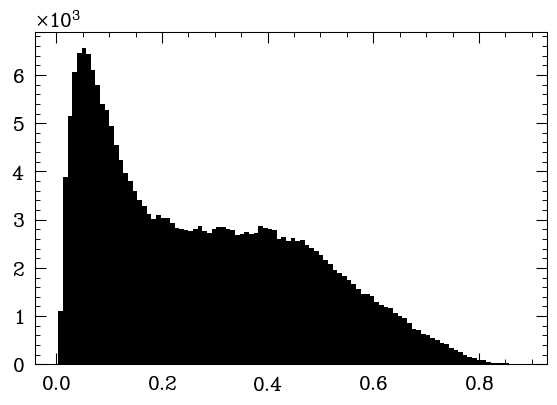

In [70]:
plt.hist(np.std(jaligns, axis=0), bins=100);

In [17]:
def half_mass_radius(radii, masses):
    total_mass = np.sum(masses)
    sorted_indices = np.argsort(radii)
    sorted_radii = radii[sorted_indices]
    cumulative_mass = np.cumsum(masses[sorted_indices])
    
    index = np.searchsorted(cumulative_mass, total_mass / 2.0)
    r1, r2 = sorted_radii[index - 1], sorted_radii[index]
    m1, m2 = cumulative_mass[index - 1], cumulative_mass[index]

    return r1 + (total_mass / 2.0 - m1) * (r2 - r1) / (m2 - m1)

In [18]:
rgals = [4 * half_mass_radius((p[4]['r_scaled'] * p[4]['Rvir'])[p[4]['r_scaled'] <= 0.15], p[4]['Masses'][p[4]['r_scaled'] <= 0.15]) / p[4]['Rvir'] for p in res]

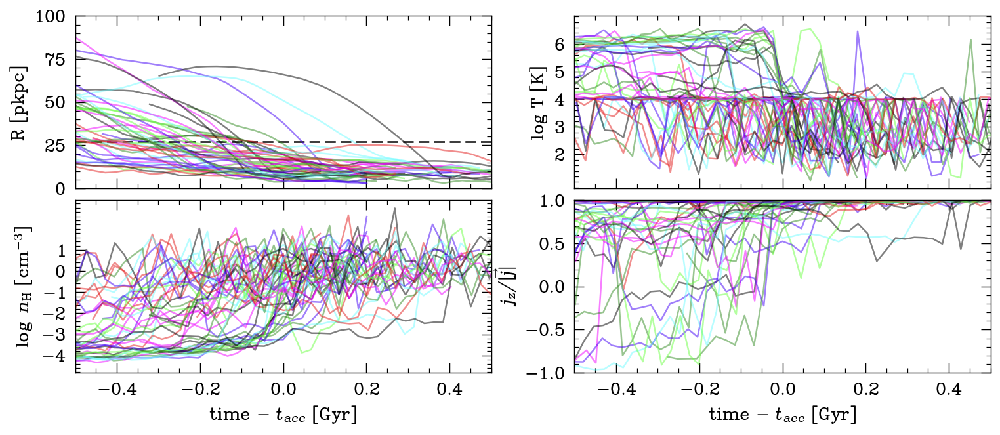

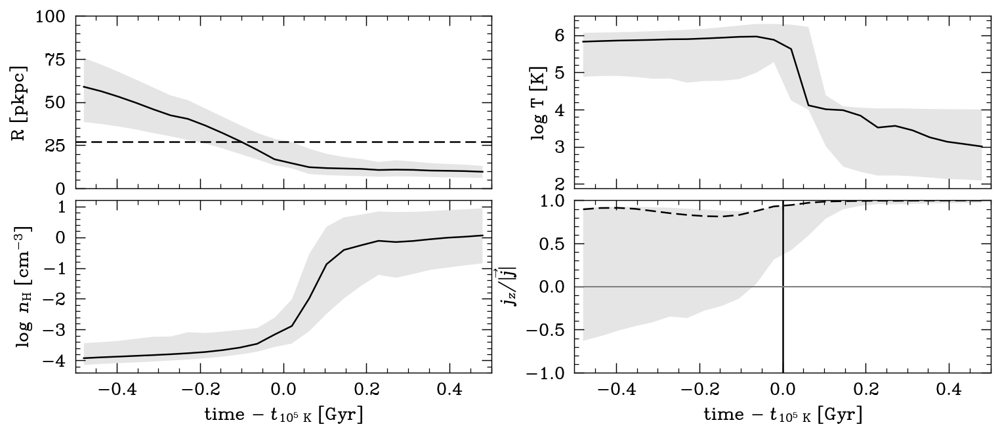

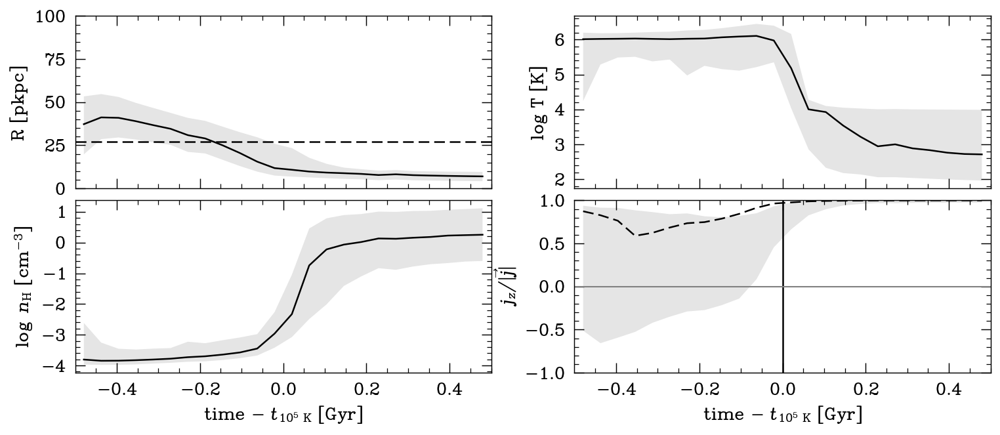

In [30]:
ridx = np.random.randint(0, Rs.shape[1], 50)
# ridx = np.random.choice(mask_hotphase, 50)
# ridx = np.flatnonzero((np.max(np.abs(xs[1:] - xs[:-1]), axis=0) < 1e1)&(np.max(np.abs(ys[1:] - ys[:-1]), axis=0) < 1e1)&(np.max(np.abs(zs[1:] - zs[:-1]), axis=0) < 1e1))
# ridx = np.random.choice(ridx, 30)

# ridx = np.flatnonzero(np.std(jaligns, axis=0) > 0.8)
# ridx = np.random.choice(ridx, 30)

plottracks(res, times, Rs[:,ridx], Ts[:,ridx], nHs[:,ridx], jaligns[:,ridx])

ridx = inrange(times[-1] - tacc, (0.5, 1))
plottracks2(res, times, Rs, Ts, nHs, jaligns, js)
plottracks2(res, times, Rs[:,ridx], Ts[:,ridx], nHs[:,ridx], jaligns[:,ridx], js[:,ridx,:])
# plt.savefig('m12i_particletracks3.png')

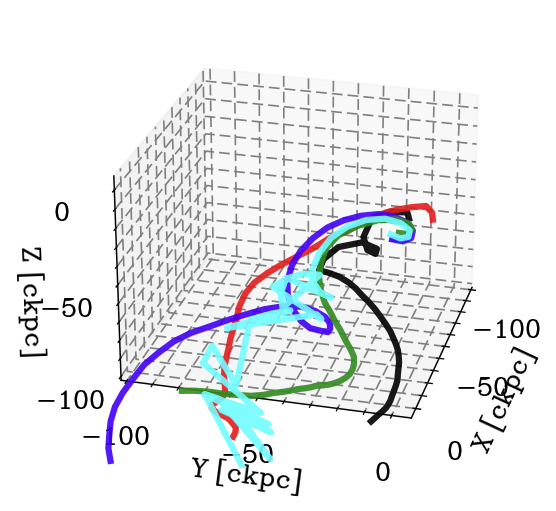

In [64]:
fig = plt.figure(dpi=150)
ax = fig.add_subplot(projection='3d')

for i in ridx[::6]:
    ax.plot(xs[:,i]-res[-1][0]['posC'][0]/ res[-1][0]['ScaleFactor'], ys[:,i]-res[-1][0]['posC'][1]/ res[-1][0]['ScaleFactor'], zs[:,i]-res[-1][0]['posC'][2]/ res[-1][0]['ScaleFactor'], alpha=0.9, lw=3)


ax.set_xlabel('X [ckpc]')
ax.set_ylabel('Y [ckpc]')
ax.set_zlabel('Z [ckpc]')

ax.set_xlim(-100, 5)
ax.set_ylim(-100, 5)
ax.set_zlim(-100, 5)

ax.view_init(azim=15, elev=25)
plt.show()

## Hot and cold mode selection

[]

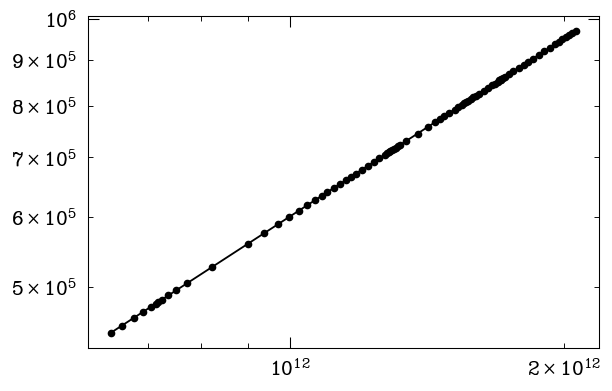

In [33]:
plt.plot([p[0]['Mvir'] for p in res],
         [6e5 * (p[0]['Mvir']/1e12)**(2/3) for p in res], '.-')
plt.loglog()

### Temperature-in-halo selection

In [61]:
ridxchoice = np.random.choice(np.flatnonzero((modes==1)&np.isin(PIDs, unique_ids_tf)&(np.std(jaligns, axis=0) > 0.8)), 50)

In [70]:
def accretionmodes(res, Rs, Ts, Rin=0.1, Rout=1, modefrac=0.8, hotmode=5.5, coldmode=4.5, plot=False):

    if plot: fig, axes = plt.subplots(10, 5, sharex=True, sharey=True, gridspec_kw={'wspace': .05, 'hspace':.07}, figsize=[4.8*5,4.8*10], dpi=150, facecolor='w', squeeze=False)

    a = res[-1-3][0]['ScaleFactor']
    rin, rout = res[-1-3][0]['Rvir']*Rin/a, res[-1-3][0]['Rvir']*Rout/a
    Tvir = 6e5 * (res[-1-3][0]['Mvir']/1e12)**(2/3)

    Tvir0 = 6e5 * (res[0][0]['Mvir']/1e12)**(2/3)
    
    modes = []

    for ip,i in enumerate(ridxchoice):#range(Rs.shape[1]):
    #     mask = iht.inrange(Rs[:,i], (rin,rout))

    #     fcold = np.sum(Ts[mask,i] <= 10**4.5) / np.sum(mask)
    #     fhot = np.sum(Ts[mask,i] >= 10**5.5) / np.sum(mask)

        yb, xb, _ = binned_statistic(Rs[:,i], np.log10(Ts[:,i]), range=(rin, rout), bins=10, statistic='mean')
#         assert(np.isfinite(yb).all())
        xb = (xb[:-1]+xb[1:])/2
        xb = xb[np.isfinite(yb)]
        yb = yb[np.isfinite(yb)]

        fcold = np.sum(yb <= coldmode) / len(yb)
        fhot = np.sum(yb >= hotmode) / len(yb)

        c = 'b' if fcold >= modefrac else 'r' if fhot >= modefrac else 'k'
        
        modes.append(-1 if fcold >= modefrac else 1 if fhot >= modefrac else 0)
        
        if plot:
            ax = axes.flatten()[ip]
            ax.plot(Rs[:,i], Ts[:,i], 'D-', c=c, lw=3);

            ax.axvline(rin, ls='--', lw=2)
            ax.axvline(rout, ls='--', lw=2)

            ax.axhline(Tvir, ls='--', c='g', lw=2)
            ax.axhline(Tvir0, ls='--', c='grey', lw=2)
            ax.axhspan(10**hotmode, 1e7, alpha=0.15, color='r')
            ax.axhspan(1e2, 10**coldmode, alpha=0.15, color='b')

        #     ax.plot(xb, 10**yb, 'o', c='g', lw=3);
    if plot:
        ax.set_yscale('log')
        ax.set_xlim(-10,90)
        ax.set_ylim(1e2,1e7)
        for ax in axes[-1]: ax.set_xlabel('R [com. kpc]')
        for ax in axes[:,0]: ax.set_ylabel('T [K]')
    
    return np.array(modes)

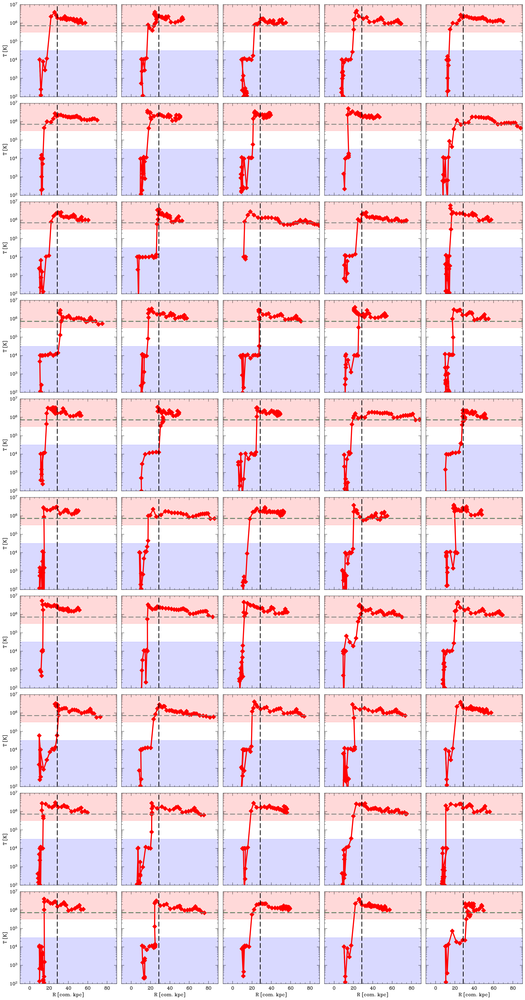

In [74]:
modes1 = accretionmodes(res, Rs, Ts, plot=True, modefrac=0.8)

In [27]:
np.sum(modes==1) / len(modes)

0.6348579879548127

### Time-in-halo selection

In [172]:
H0 = res[-1-3][0]['HubbleParam']*100*un.km/un.s/un.Mpc
H = H0 * iht.Ez(res[-1-3][0]['Omega0'], res[-1-3][0]['OmegaLambda'], res[-1-3][0]['Redshift'])

tff = (0.1/H).to(un.Gyr)

In [173]:
from itertools import groupby
from operator import itemgetter

# https://stackoverflow.com/a/2154437
def consecutiverangesmax(arr):
    ranges =[]

    for k,g in groupby(enumerate(arr),lambda x:x[0]-x[1]):
        group = (map(itemgetter(1),g))
        group = list(map(int,group))
        ranges.append((group[0],group[-1]))
    return ranges[np.argmax([y-x for x,y in ranges])]

In [174]:
def accretionmodes2(res, Rs, times, Rin=0.1, Rout=1, plot=False):

    if plot: fig, axes = plt.subplots(10, 5, sharex=True, sharey=True, gridspec_kw={'wspace': .05, 'hspace':.07}, figsize=[4.8*5,4.8*10], dpi=150, facecolor='w', squeeze=False)

    a = res[-1-3][0]['ScaleFactor']
    rin, rout = res[-1-3][0]['Rvir']*Rin/a, res[-1-3][0]['Rvir']*Rout/a
    
    modes = []

    for i in range(Rs.shape[1]):
        
        mask = inrange(Rs[:,i]/rout, (0.1, 1))
        t0, t1 = consecutiverangesmax(np.flatnonzero(mask))
        
        thalo = times[t1] - times[t0]
        tratio = thalo/tff.value

        cl = 'b' if tratio < 1 else 'r' if tratio > 2 else 'grey'
        
        modes.append(-1 if tratio < 1 else 1 if tratio > 2 else 0)
        
        if plot:
            ax = axes.flatten()[i]
            ax.scatter(times, Rs[:,i], c=np.where(mask, 'g', 'k'));

            ax.axhline(rin, ls='--', lw=2)
            ax.axhline(rout, ls='--', lw=2)
            
            ax.axvspan(times[t0], times[t1], color=cl, alpha=0.25)
            
            ax.text(times[t0], 0.8e3, f'$t_{{halo}}/t_{{ff}}=$\n{tratio:.2f}', size=25)

    if plot:
        for ax in axes[-1]: ax.set_xlabel('time [Gyr]')
        for ax in axes[:,0]: ax.set_ylabel('R [com. kpc]')
    
    return np.array(modes)

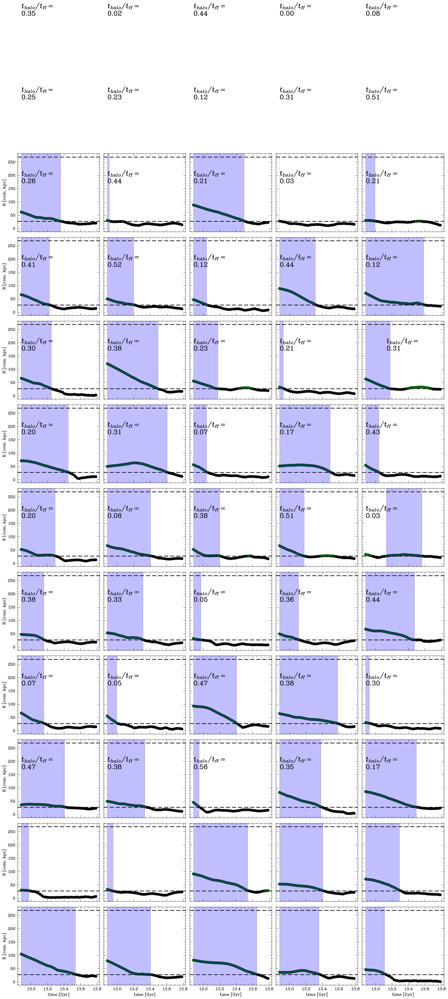

In [175]:
modes = accretionmodes2(res, Rs, times, plot=True)

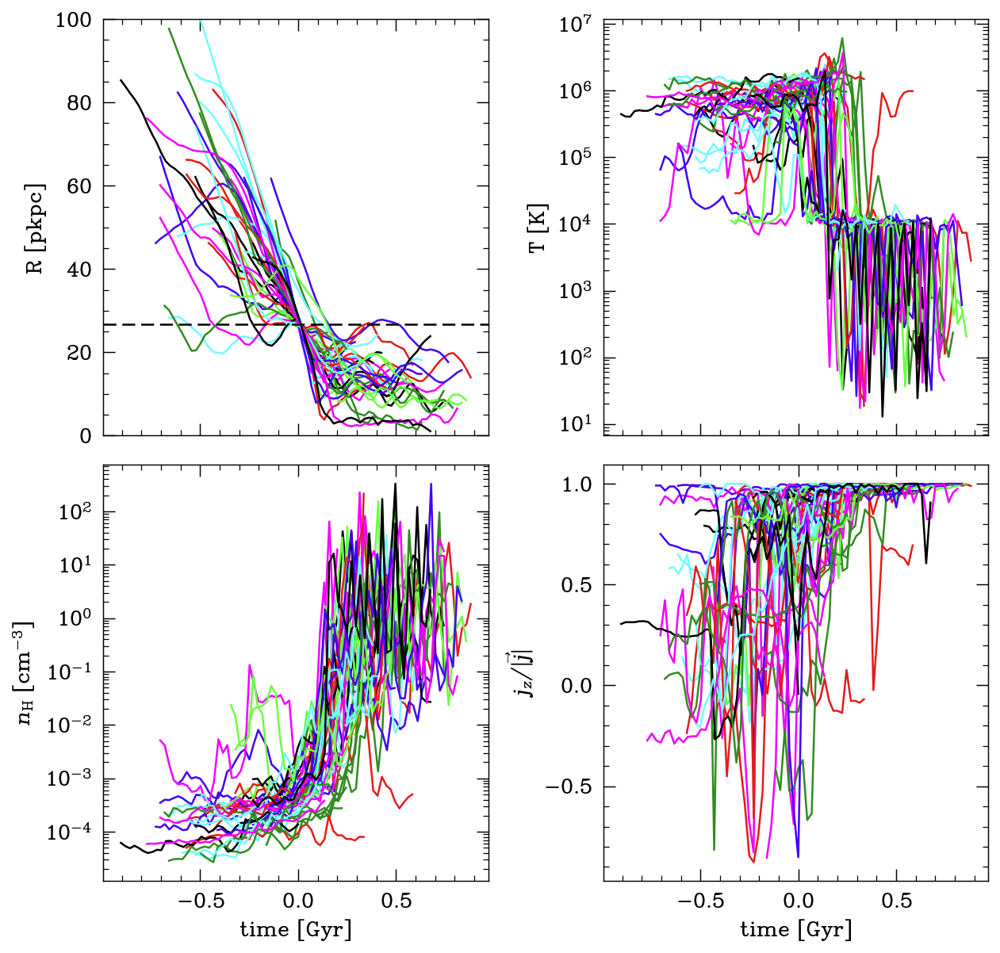

In [178]:
plottracks(res, times, Rs[:,modes==-1], Ts[:,modes==-1], nHs[:,modes==-1], jaligns[:,modes==-1])

In [25]:
print(mpl.rcParams['axes.prop_cycle'])

cycler('color', ['k', '#e31c1c', '#4200f7', '#328b22', '#71fcff', '#f100ff', '#6bff42'])


ValueError: x and y must have same first dimension, but have shapes (0,) and (41, 0)

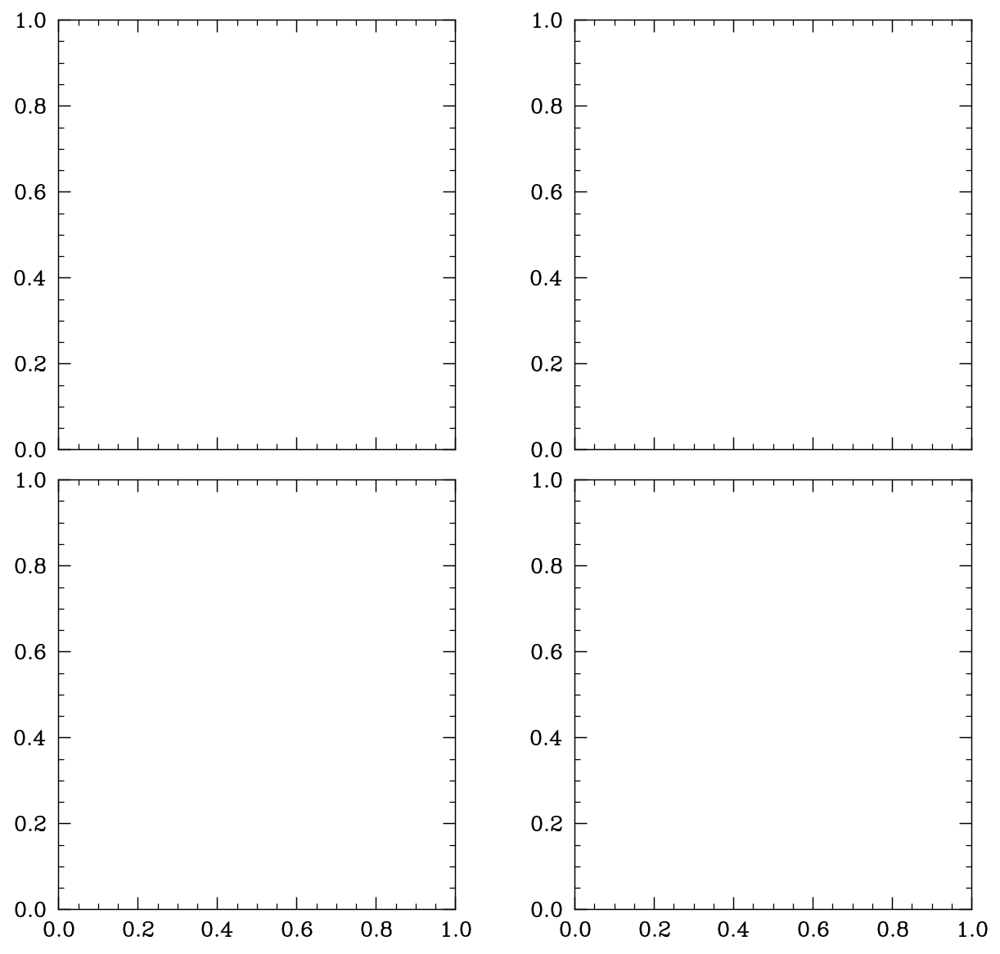

In [177]:
plottracks(res, times, Rs[:,modes==1], Ts[:,modes==1], nHs[:,modes==1], jaligns[:,modes==1])

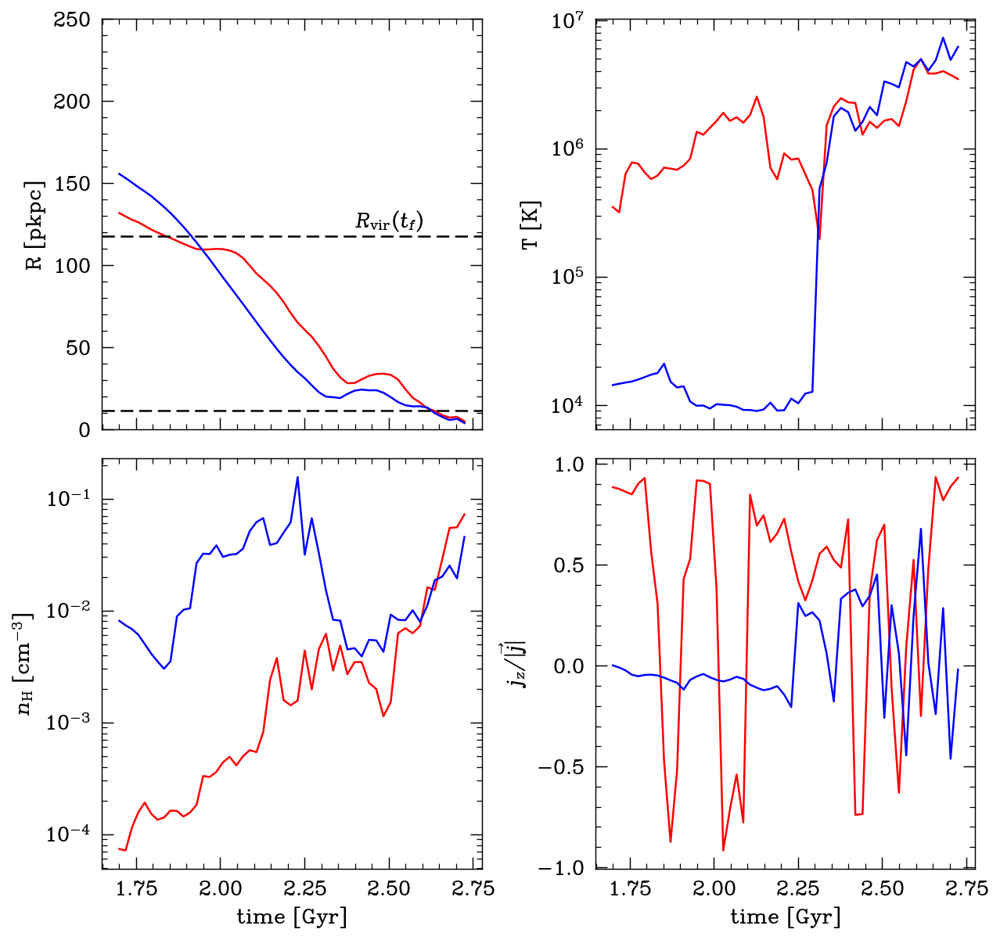

In [42]:
mpl.rcParams['axes.prop_cycle'] = mpl.cycler(color=["r", "b", "k", 'g']) 
plottracks(res, times, Rs[:,[45,47]], Ts[:,[45,47]], nHs[:,[45,47]], jaligns[:,[45,47]])
plt.savefig('exampletracks.png')

# Particle trajectories

Text(0, 0.5, 'y [com. kpc]')

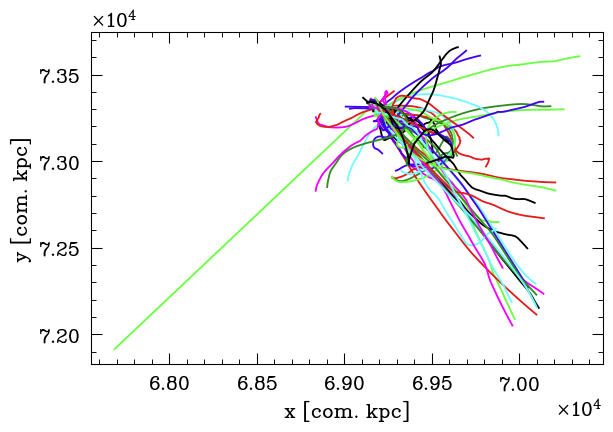

In [91]:
plt.plot(xs, ys);
plt.xlabel('x [com. kpc]')
plt.ylabel('y [com. kpc]')

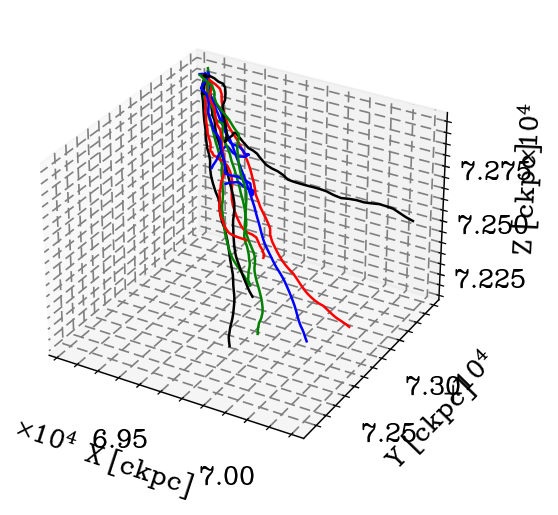

In [43]:
fig = plt.figure(dpi=150)
ax = fig.add_subplot(projection='3d')

for i in range(50): 
    if modes[i]==1:
        ax.plot(xs[:,i], ys[:,i], zs[:,i])

ax.set_xlabel('X [ckpc]')
ax.set_ylabel('Y [ckpc]')
ax.set_zlabel('Z [ckpc]')

plt.show()

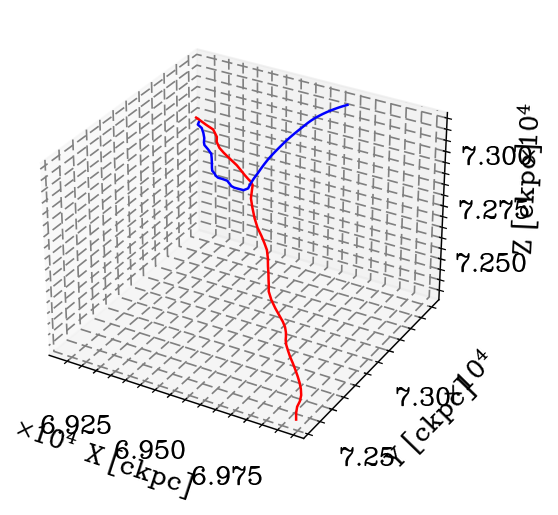

In [45]:
fig = plt.figure(dpi=150)
ax = fig.add_subplot(projection='3d')

for i in [45,47]: 
    ax.plot(xs[:,i], ys[:,i], zs[:,i])

ax.set_xlabel('X [ckpc]')
ax.set_ylabel('Y [ckpc]')
ax.set_zlabel('Z [ckpc]')

plt.show()

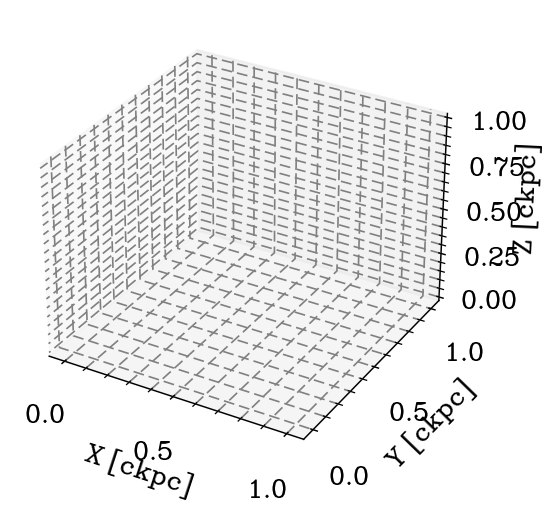

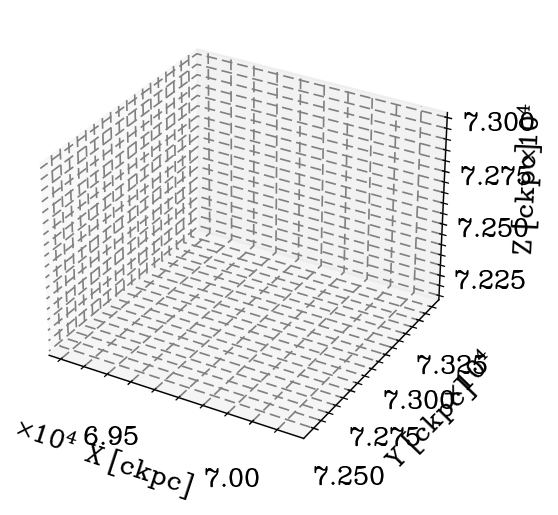

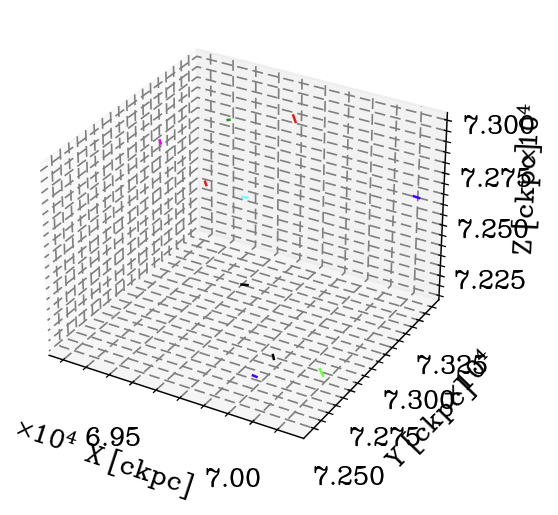

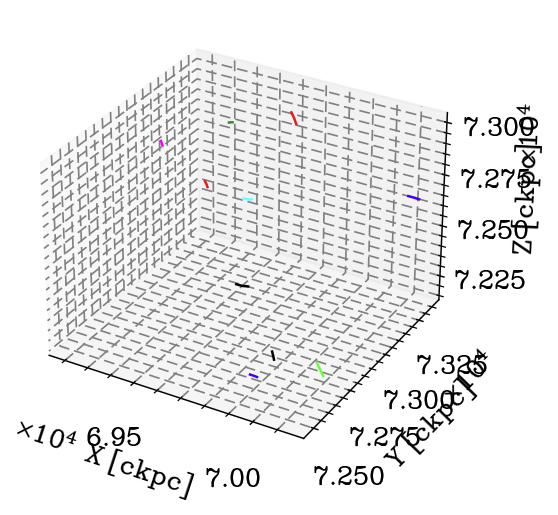

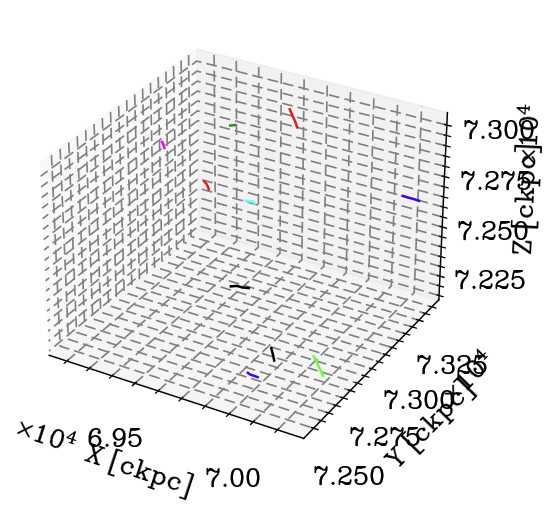

...

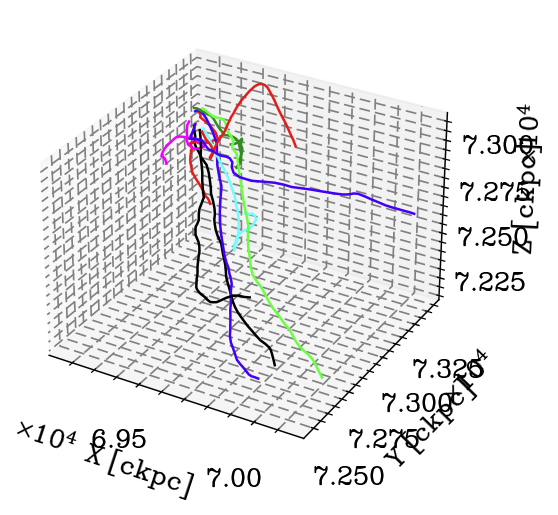

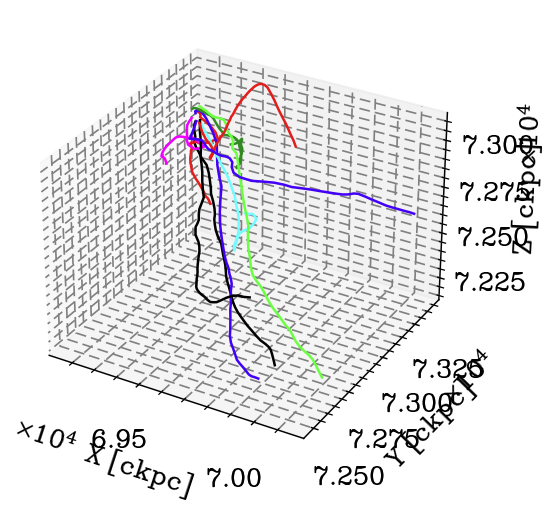

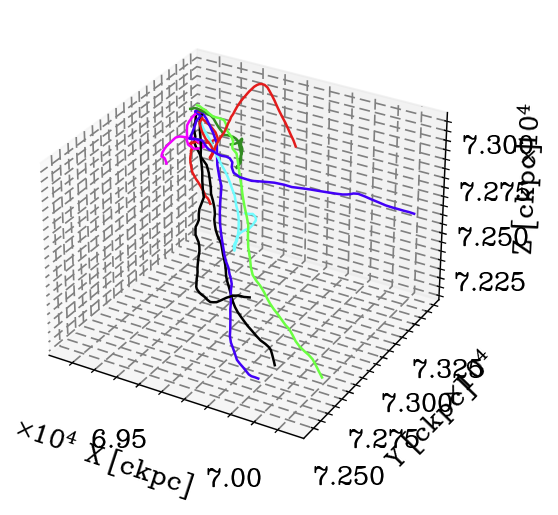

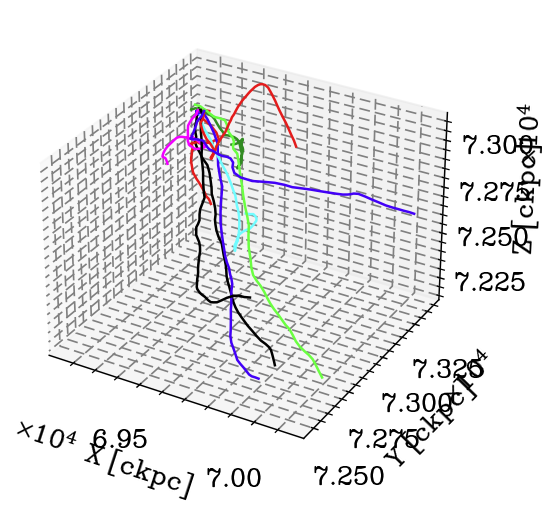

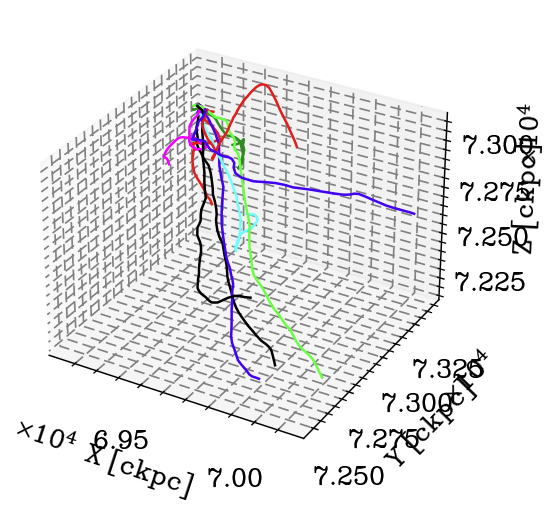

In [77]:
for ti in range(xs.shape[0]):
    fig = plt.figure(dpi=150)
    ax = fig.add_subplot(projection='3d')

    for i in range(50): 
        if modes[i]==1:
            ax.plot(xs[:ti,i], ys[:ti,i], zs[:ti,i])

    ax.set_xlabel('X [ckpc]')
    ax.set_ylabel('Y [ckpc]')
    ax.set_zlabel('Z [ckpc]')

    plt.savefig(f'tih206/{ti:03d}.png')

In [78]:
from PIL import Image

image_array = [Image.open(f'tih206/{ti:03d}.png') for ti in range(xs.shape[0])]

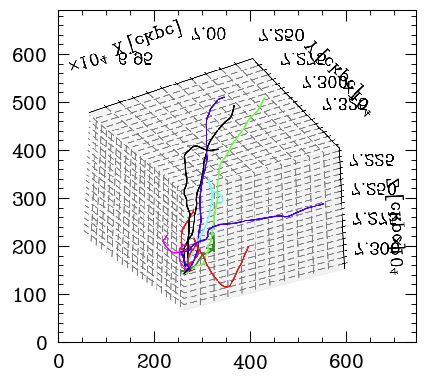

In [79]:
import matplotlib.animation as animation

# Create the figure and axes objects
fig, ax = plt.subplots()

# Set the initial image
im = ax.imshow(image_array[0], animated=True)

def update(i):
    im.set_array(image_array[i])
    return im, 

# Create the animation object
animation_fig = animation.FuncAnimation(fig, update, frames=len(image_array), interval=200, blit=True,repeat_delay=10,)

# Show the animation
# plt.show()

animation_fig.save("tih206/animated_GMM.gif")